# <span style="color:blue"> Imputation 
</span>

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.impute import KNNImputer
from sklearn.metrics import r2_score
from mpl_toolkits.axes_grid1 import make_axes_locatable

## Basic Data Processing

In [2]:
df = pd.read_csv('Merged_Chem.csv')
df

,Unnamed: 0,Unique ID,NTS Sheet,Latitude_NAD83,Longitude_NAD83,Old Zn,Old Cu,Old Pb,Old Ni,Old Co,...,New Ti,New Tl,New Tm,New U,New V,New W,New Y,New Yb,New Zn,New Zr
0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,013L781002,013L,54.989093,-62.019071,40.0,38.0,NaN,43.0,10.0,...,0.021,0.03,0.10,0.3,31.0,NaN,6.04,0.64,44.0,0.9
2,2,013L781003,013L,54.975382,-62.030577,40.0,44.0,NaN,35.0,8.0,...,0.021,0.03,0.08,0.3,45.0,NaN,5.65,0.49,45.1,1.0
3,3,013L781004,013L,54.976331,-62.044913,46.0,30.0,NaN,34.0,8.0,...,0.023,0.04,0.09,0.3,17.0,NaN,7.19,0.64,51.4,0.8
4,4,013L781005,013L,54.973541,-62.054790,50.0,26.0,NaN,22.0,6.0,...,0.014,0.03,0.12,0.6,34.0,NaN,8.08,0.74,51.1,0.8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3437,3437,023J783278,023J,54.483518,-66.172597,192.0,68.0,8.0,58.0,24.0,...,0.037,0.21,0.32,5.4,51.0,NaN,23.40,1.87,245.6,7.3
3438,3438,023J783279,023J,54.482485,-66.128816,132.0,32.0,3.0,28.0,6.0,...,0.022,0.09,0.18,1.9,25.0,NaN,12.76,1.01,140.3,6.0
3439,3439,023J783282,023J,54.483288,-66.094340,138.0,34.0,6.0,36.0,13.0,...,0.049,0.13,0.13,2.3,38.0,NaN,9.84,0.87,135.4,10.9
3440,3440,023J783283,023J,54.471281,-66.048911,168.0,46.0,6.0,25.0,7.0,...,0.009,0.08,0.16,1.6,10.0,NaN,14.21,1.07,179.3,2.6


In [3]:
#Drop the first row
df = df.iloc[1:].reset_index(drop=True)
df

,Unnamed: 0,Unique ID,NTS Sheet,Latitude_NAD83,Longitude_NAD83,Old Zn,Old Cu,Old Pb,Old Ni,Old Co,...,New Ti,New Tl,New Tm,New U,New V,New W,New Y,New Yb,New Zn,New Zr
0,1,013L781002,013L,54.989093,-62.019071,40.0,38.0,NaN,43.0,10.0,...,0.021,0.03,0.10,0.3,31.0,NaN,6.04,0.64,44.0,0.9
1,2,013L781003,013L,54.975382,-62.030577,40.0,44.0,NaN,35.0,8.0,...,0.021,0.03,0.08,0.3,45.0,NaN,5.65,0.49,45.1,1.0
2,3,013L781004,013L,54.976331,-62.044913,46.0,30.0,NaN,34.0,8.0,...,0.023,0.04,0.09,0.3,17.0,NaN,7.19,0.64,51.4,0.8
3,4,013L781005,013L,54.973541,-62.054790,50.0,26.0,NaN,22.0,6.0,...,0.014,0.03,0.12,0.6,34.0,NaN,8.08,0.74,51.1,0.8
4,5,013L781007,013L,54.936983,-62.026399,42.0,20.0,NaN,22.0,9.0,...,0.021,0.05,0.10,0.3,28.0,NaN,7.53,0.61,45.4,0.9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3436,3437,023J783278,023J,54.483518,-66.172597,192.0,68.0,8.0,58.0,24.0,...,0.037,0.21,0.32,5.4,51.0,NaN,23.40,1.87,245.6,7.3
3437,3438,023J783279,023J,54.482485,-66.128816,132.0,32.0,3.0,28.0,6.0,...,0.022,0.09,0.18,1.9,25.0,NaN,12.76,1.01,140.3,6.0
3438,3439,023J783282,023J,54.483288,-66.094340,138.0,34.0,6.0,36.0,13.0,...,0.049,0.13,0.13,2.3,38.0,NaN,9.84,0.87,135.4,10.9
3439,3440,023J783283,023J,54.471281,-66.048911,168.0,46.0,6.0,25.0,7.0,...,0.009,0.08,0.16,1.6,10.0,NaN,14.21,1.07,179.3,2.6


In [4]:
#Convert 'LOI' column to numeric, handling errors by coercing
df['LOI'] = np.abs(pd.to_numeric(df['LOI'], errors='coerce'))
df.head() 

,Unnamed: 0,Unique ID,NTS Sheet,Latitude_NAD83,Longitude_NAD83,Old Zn,Old Cu,Old Pb,Old Ni,Old Co,...,New Ti,New Tl,New Tm,New U,New V,New W,New Y,New Yb,New Zn,New Zr
0,1,013L781002,013L,54.989093,-62.019071,40.0,38.0,NaN,43.0,10.0,...,0.021,0.03,0.10,0.3,31.0,NaN,6.04,0.64,44.0,0.9
1,2,013L781003,013L,54.975382,-62.030577,40.0,44.0,NaN,35.0,8.0,...,0.021,0.03,0.08,0.3,45.0,NaN,5.65,0.49,45.1,1.0
2,3,013L781004,013L,54.976331,-62.044913,46.0,30.0,NaN,34.0,8.0,...,0.023,0.04,0.09,0.3,17.0,NaN,7.19,0.64,51.4,0.8
3,4,013L781005,013L,54.973541,-62.054790,50.0,26.0,NaN,22.0,6.0,...,0.014,0.03,0.12,0.6,34.0,NaN,8.08,0.74,51.1,0.8
4,5,013L781007,013L,54.936983,-62.026399,42.0,20.0,NaN,22.0,9.0,...,0.021,0.05,0.10,0.3,28.0,NaN,7.53,0.61,45.4,0.9


In [5]:
element_lst = [col for col in df.columns if ('Old') in col] + [col for col in df.columns if ('New') in col]

In [6]:
count_df = pd.DataFrame([[element, df[element].isna().mean()] for element in element_lst], columns=['Element', 'Fraction Missing'])
count_df

,Element,Fraction Missing
0,Old Zn,0.000000
1,Old Cu,0.000000
2,Old Pb,0.377216
3,Old Ni,0.000872
4,Old Co,0.007265
...,...,...
73,New W,0.402499
74,New Y,0.000291
75,New Yb,0.000291
76,New Zn,0.000291


In [7]:
count_df = count_df.sort_values(by = 'Fraction Missing')
count_df

,Element,Fraction Missing
0,Old Zn,0.000000
1,Old Cu,0.000000
6,Old Mn,0.000000
7,Old Fe,0.000000
11,Old Hg,0.000000
...,...,...
5,Old Ag,0.823888
54,New Pt,0.857600
52,New Pd,0.993607
17,New B,0.998838


In [8]:
discard_elements = [element for element in element_lst if df[element].isna().sum()/len(df)>=0.1]
discard_elements

['Old Pb',
 'Old Ag',
 'Old As',
 'Old Mo',
 'New As',
 'New Au',
 'New B',
 'New Bi',
 'New Ge',
 'New Hf',
 'New In',
 'New Pd',
 'New Pt',
 'New Re',
 'New Sb',
 'New Sn',
 'New Ta',
 'New Te',
 'New W']

## imputation for New Sn

In [9]:
demo_elements = [element for element in element_lst if (df[element].isna().sum()/len(df)>0.01) and (df[element].isna().sum()/len(df)>0.1)]
demo_elements

['Old Pb',
 'Old Ag',
 'Old As',
 'Old Mo',
 'New As',
 'New Au',
 'New B',
 'New Bi',
 'New Ge',
 'New Hf',
 'New In',
 'New Pd',
 'New Pt',
 'New Re',
 'New Sb',
 'New Sn',
 'New Ta',
 'New Te',
 'New W']

In [10]:
imputer = KNNImputer(n_neighbors=10)

In [11]:
#create a list of names for imputed columns
imputed_elements = ['Imputed '+elem for elem in discard_elements]

In [12]:
df[imputed_elements] = pd.DataFrame(imputer.fit_transform(df[discard_elements]))
df.describe()

,Unnamed: 0,Latitude_NAD83,Longitude_NAD83,Old Zn,Old Cu,Old Pb,Old Ni,Old Co,Old Ag,Old Mn,...,Imputed New Hf,Imputed New In,Imputed New Pd,Imputed New Pt,Imputed New Re,Imputed New Sb,Imputed New Sn,Imputed New Ta,Imputed New Te,Imputed New W
count,3441.000000,3441.000000,3441.000000,3441.000000,3441.000000,2143.000000,3438.000000,3416.000000,606.000000,3441.000000,...,3441.000000,3441.000000,3441.000000,3441.000000,3441.000000,3441.000000,3441.000000,3441.000000,3441.00000,3441.000000
mean,1721.000000,55.383663,-63.778378,111.829119,28.005522,3.614559,17.569226,10.814110,0.278053,662.333333,...,0.056163,0.027175,15.744694,2.706200,2.757869,0.095022,0.331578,0.060000,0.03691,0.362277
std,993.475465,0.853529,1.451083,104.297344,23.771434,2.526390,18.533247,11.908128,0.182716,3055.596946,...,0.102146,0.006537,2.443843,0.425822,2.544043,0.200991,0.299877,0.000241,0.01169,0.598008
min,1.000000,54.005243,-66.997815,14.000000,2.000000,2.000000,2.000000,2.000000,0.200000,10.000000,...,0.020000,0.020000,10.000000,2.000000,1.000000,0.020000,0.100000,0.050000,0.02000,0.100000
25%,861.000000,54.646363,-64.884206,62.000000,14.000000,2.000000,8.000000,5.000000,0.200000,95.000000,...,0.030000,0.024000,13.700000,2.500000,1.900000,0.030000,0.200000,0.060000,0.03100,0.170000
50%,1721.000000,55.238594,-63.316447,90.000000,22.000000,3.000000,12.000000,8.000000,0.200000,160.000000,...,0.034000,0.026000,15.200000,2.700000,2.100000,0.040000,0.300000,0.060000,0.03500,0.200000
75%,2581.000000,56.136332,-62.667055,132.000000,34.000000,4.000000,21.000000,12.000000,0.300000,350.000000,...,0.046000,0.030000,17.600000,2.900000,3.000000,0.073000,0.400000,0.060000,0.04000,0.380000
max,3441.000000,56.997959,-62.001419,2800.000000,355.000000,38.000000,290.000000,178.000000,1.800000,99999.000000,...,3.670000,0.160000,42.000000,7.000000,45.000000,7.300000,5.100000,0.070000,0.16000,18.400000


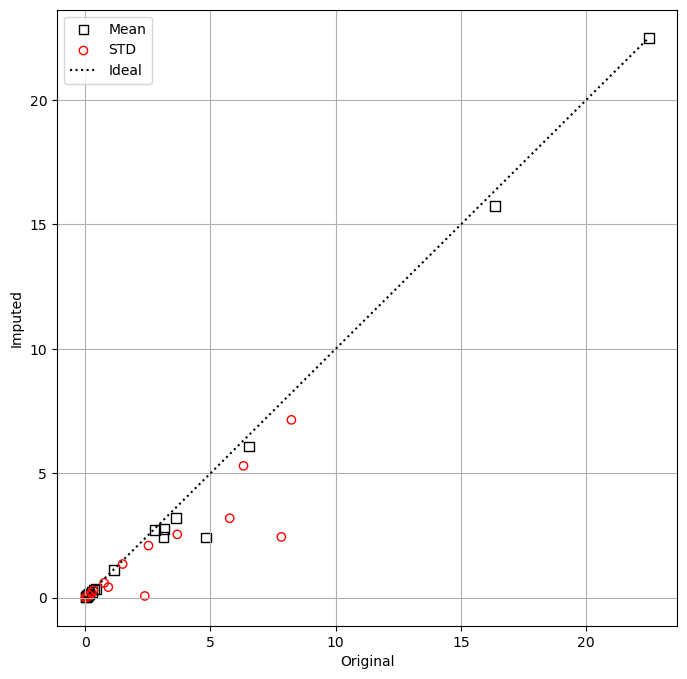

In [13]:
plt.figure(figsize = (8,8))


plt.scatter(df[discard_elements].mean(), df[imputed_elements].mean(), 
            label = 'Mean', marker = 's', facecolor = 'none', edgecolor = 'black', s = 50)

plt.scatter(df[discard_elements].std(), df[imputed_elements].std(), 
            label = 'STD', facecolor = 'none', edgecolor = 'red')


lim = max(max(df[discard_elements].mean()), max(df[imputed_elements].mean()), max(df[discard_elements].std()), max(df[imputed_elements].std()))

plt.plot([0,lim],[0,lim], linestyle = ':', color = 'k', label = 'Ideal')

plt.legend()
plt.xlabel('Original')
plt.ylabel('Imputed')
plt.grid()
plt.show()

The plot compares the mean and standard deviation of original features to those of imputed features. The diagonal/dotted line represents a perfect match between the two. Imputed features closely resemble the original ones in terms of mean and standard deviation, indicating effective imputation by the KNN algorithm. However, there are some outliers which show differences, suggesting that in a few cases imputation was less precise.

In [14]:
from sklearn.metrics import r2_score

r2_1st = []

for n in range(1, 100, 1):
    
    
    imputer = KNNImputer(n_neighbors=n, weights = 'distance')
    
    df[imputed_elements] = pd.DataFrame(imputer.fit_transform(df[discard_elements]), columns = discard_elements)
    
    r2_1st.append([n, r2_score(df[discard_elements].mean(), df[imputed_elements].mean()), r2_score(df[discard_elements].std(), df[imputed_elements].std())])

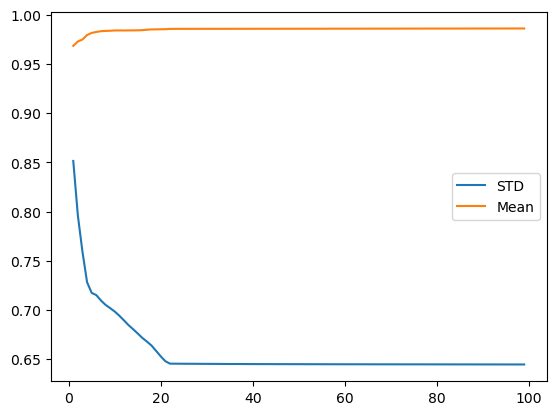

In [15]:
r2_df = pd.DataFrame(r2_1st, columns = ['N', 'Mean', 'STD'])
plt.plot(r2_df.N, r2_df.STD, label = 'STD')
plt.plot(r2_df.N, r2_df.Mean, label = 'Mean')
plt.legend()

(array([483.,   0., 808., 606.,   0.,   0., 431.,   0., 239.,   0., 135.,
         63.,   0.,   0.,  40.,   0.,  30.,   0.,  15.,   0.,   8.,   7.,
          0.,   7.,   0.,   3.,   0.,   4.,   0.,   0.,   2.,   4.,   0.,
          1.,   0.,   0.,   0.,   0.,   4.,   0.,   1.,   0.,   2.,   1.,
          0.,   4.,   0.,   1.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          2.,   0.,   0.,   0.,   0.,   1.,   0.,   1.,   0.,   0.,   1.,
          0.,   0.,   0.,   0.,   0.,   0.,   1.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   2.,   0.,
          0.,   0.,   0.,   0.,   1.,   0.,   0.,   0.,   0.,   0.,   0.,
          1.]),
 array([0.1 , 0.15, 0.2 , 0.25, 0.3 , 0.35, 0.4 , 0.45, 0.5 , 0.55, 0.6 ,
        0.65, 0.7 , 0.75, 0.8 , 0.85, 0.9 , 0.95, 1.  , 1.05, 1.1 , 1.15,
        1.2 , 1.25, 1.3 , 1.35, 1.4 , 1.45, 1.5 , 1.55, 1.6 , 1.65, 1.7 ,
        1.75, 1.8 , 1.85, 1.9 , 1.95, 2.  , 2.05, 2.1 , 2.15, 2.2 , 2.25,
        2.3 , 2.35, 2.

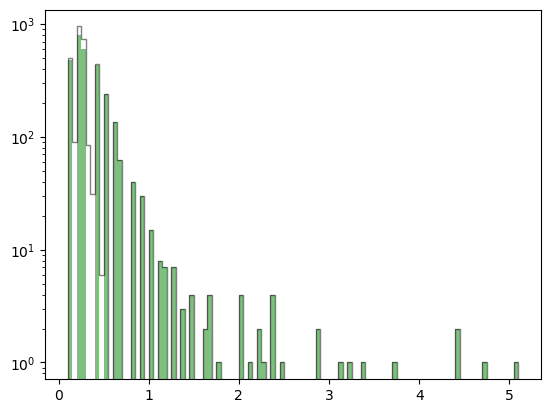

In [16]:
plt.hist(df['Imputed New Sn'], bins = 100, alpha = 0.5, histtype = 'step', log = True, color = 'k')
plt.hist(df['New Sn'], bins = 100, alpha = 0.5, log = True, color = 'green')

The plot shows two histograms, one for the original New Sn feature (green) and one for the imputed New Sn feature (black). The histograms are both plotted on a log scale, which means that the y-axis represents the frequency of values on a logarithmic scale.The two histograms overlap closely, which suggests that the distribution of the imputed New Sn feature is very similar to the distribution of the original New Sn feature.

In [17]:
chemical = 'New Sn'

In [18]:
r2_1st = []

for n in range(1, 100, 1):
    
    imputer = KNNImputer(n_neighbors=n, weights = 'distance')
    
    df[imputed_elements] = pd.DataFrame(imputer.fit_transform(df[discard_elements]), columns = discard_elements)
    
    imput_hist = plt.hist(df[imputed_elements[discard_elements.index(chemical)]], bins = 100, log = True)
    orig_hist = plt.hist(df[chemical].dropna(), bins = 100, range = (df[imputed_elements[discard_elements.index(chemical)]].min(), df[imputed_elements[discard_elements.index(chemical)]].max()), log = True)
    
    plt.close()
    r2_1st.append([n, r2_score(orig_hist[0], imput_hist[0])])


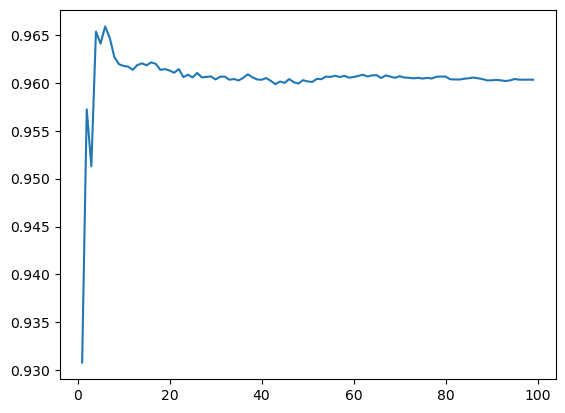

In [19]:
r2_df = pd.DataFrame(r2_1st, columns = ['N', 'R2'])

plt.plot(r2_df.N, r2_df.R2)

The line plot shows the R2 score (y-axis) vs. the number of neighbors (x-axis) used in the KNN imputation algorithm. The line plot shows that the R2 score increases with the number of neighbors, up to a point, and then starts to plateau suggesting that using a moderate number of neighbors between is a good way to achieve a good imputation of the missing values. The R2 score is above 0.9 for all values of the number of neighbors and the rate of increase in the score starts to slow down after about 20 neighbors.

In [20]:
r2_df.R2.max()

0.965887361939913

In [21]:
r2_df[r2_df.R2 == r2_df.R2.max()]

,N,R2
5,6,0.965887


An R2 score of 0.965887 suggests that imputed values for the chemical New Sn are closely matching the original values when using 6 neighbors for KNN imputation.

In [22]:
imputer = KNNImputer(n_neighbors = 6, weights = 'distance')

df[imputed_elements] = pd.DataFrame(imputer.fit_transform(df[discard_elements]), columns = discard_elements)
df.describe()

,Unnamed: 0,Latitude_NAD83,Longitude_NAD83,Old Zn,Old Cu,Old Pb,Old Ni,Old Co,Old Ag,Old Mn,...,Imputed New Hf,Imputed New In,Imputed New Pd,Imputed New Pt,Imputed New Re,Imputed New Sb,Imputed New Sn,Imputed New Ta,Imputed New Te,Imputed New W
count,3441.000000,3441.000000,3441.000000,3441.000000,3441.000000,2143.000000,3438.000000,3416.000000,606.000000,3441.000000,...,3441.000000,3441.000000,3441.000000,3441.000000,3441.000000,3441.000000,3441.000000,3441.000000,3441.000000,3441.000000
mean,1721.000000,55.383663,-63.778378,111.829119,28.005522,3.614559,17.569226,10.814110,0.278053,662.333333,...,0.055505,0.027228,14.555634,2.809992,2.823131,0.094963,0.330790,0.057705,0.038318,0.360992
std,993.475465,0.853529,1.451083,104.297344,23.771434,2.526390,18.533247,11.908128,0.182716,3055.596946,...,0.102845,0.007414,2.355121,0.648250,2.677662,0.201671,0.300628,0.001631,0.016203,0.601324
min,1.000000,54.005243,-66.997815,14.000000,2.000000,2.000000,2.000000,2.000000,0.200000,10.000000,...,0.020000,0.020000,10.000000,2.000000,1.000000,0.020000,0.100000,0.050000,0.020000,0.100000
25%,861.000000,54.646363,-64.884206,62.000000,14.000000,2.000000,8.000000,5.000000,0.200000,95.000000,...,0.030000,0.021667,13.290666,2.333333,1.666667,0.030000,0.200000,0.056718,0.030000,0.162820
50%,1721.000000,55.238594,-63.316447,90.000000,22.000000,3.000000,12.000000,8.000000,0.200000,160.000000,...,0.033333,0.026667,14.085148,2.800000,2.000000,0.040000,0.300000,0.057728,0.035000,0.200000
75%,2581.000000,56.136332,-62.667055,132.000000,34.000000,4.000000,21.000000,12.000000,0.300000,350.000000,...,0.046667,0.030000,15.000000,3.000000,3.000000,0.070000,0.400000,0.058080,0.042059,0.383333
max,3441.000000,56.997959,-62.001419,2800.000000,355.000000,38.000000,290.000000,178.000000,1.800000,99999.000000,...,3.670000,0.160000,42.000000,7.000000,45.000000,7.300000,5.100000,0.070000,0.160000,18.400000


In [23]:
orig_hist[0]

array([483.,   0., 808., 606.,   0.,   0., 431.,   0., 239.,   0., 135.,
        63.,   0.,   0.,  40.,   0.,  30.,   0.,  15.,   0.,   8.,   7.,
         0.,   7.,   0.,   3.,   0.,   4.,   0.,   0.,   2.,   4.,   0.,
         1.,   0.,   0.,   0.,   0.,   4.,   0.,   1.,   0.,   2.,   1.,
         0.,   4.,   0.,   1.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
         2.,   0.,   0.,   0.,   0.,   1.,   0.,   1.,   0.,   0.,   1.,
         0.,   0.,   0.,   0.,   0.,   0.,   1.,   0.,   0.,   0.,   0.,
         0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   2.,   0.,
         0.,   0.,   0.,   0.,   1.,   0.,   0.,   0.,   0.,   0.,   0.,
         1.])

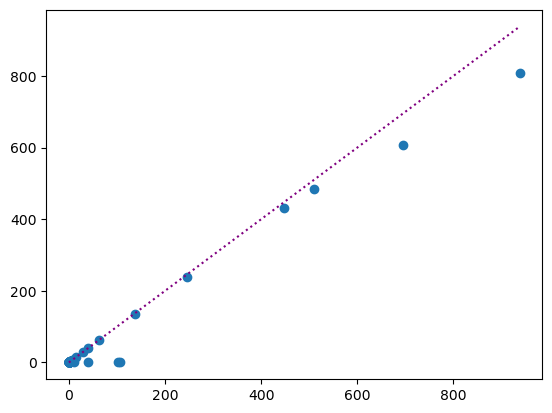

In [24]:
imput_hist = np.histogram(df[imputed_elements[discard_elements.index(chemical)]], bins = 100)
orig_hist = np.histogram(df[chemical].dropna(), bins = 100, range = (df[imputed_elements[discard_elements.index(chemical)]].min(), df[imputed_elements[discard_elements.index(chemical)]].max()))

lim = max(max(imput_hist[0]), max(orig_hist[0]))
plt.plot([0,lim],[0,lim], linestyle = ':', color = 'purple', label = 'Ideal')

plt.scatter(imput_hist[0], orig_hist[0])

The plot shows the goodness of fit between the original and new histogram, and it indicates that at low counts of the bars there is a good fit as compared to high counts highlighting that the distribution does not match well as there are a few outliers where the imputed values are significantly different from the original values. 

C:\Users\mademow\AppData\Local\Temp\ipykernel_19560\4263018192.py:10: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colormap1=plt.cm.get_cmap('jet_r', len(discard_elements))
C:\Users\mademow\AppData\Local\Temp\ipykernel_19560\4263018192.py:11: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colormap2=plt.cm.get_cmap('jet', len(discard_elements))


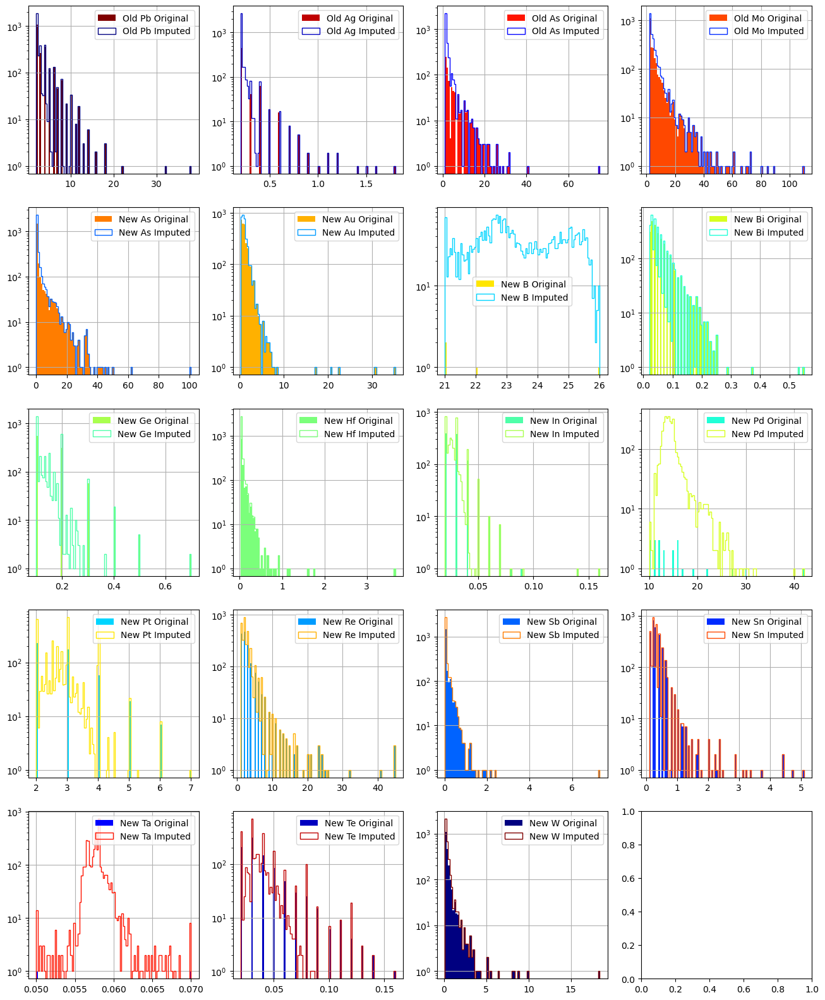

In [25]:
figs_col = 4

num_rows = int(np.ceil(len(discard_elements)/figs_col))
fig_size = 4

fig, axes = plt.subplots(num_rows, figs_col, figsize = (fig_size*figs_col, fig_size*num_rows))

i=0

colormap1=plt.cm.get_cmap('jet_r', len(discard_elements))
colormap2=plt.cm.get_cmap('jet', len(discard_elements))

for chemical in discard_elements:
    ax = axes[i//4, i%4]
    
    ax.hist(df[chemical], bins = 100, color = colormap1(i), 
            label = chemical+' Original', log = True)
    ax.hist(df[imputed_elements[discard_elements.index(chemical)]], bins = 100, color = colormap2(i), 
            label = chemical+' Imputed', log = True, histtype = 'step')
    
    i = i+1
    
    ax.legend()
    ax.grid()
    
plt.show()

In [26]:
imputed_demo_elements = ['Imputed '+element for element in demo_elements]
imputed_demo_elements

['Imputed Old Pb',
 'Imputed Old Ag',
 'Imputed Old As',
 'Imputed Old Mo',
 'Imputed New As',
 'Imputed New Au',
 'Imputed New B',
 'Imputed New Bi',
 'Imputed New Ge',
 'Imputed New Hf',
 'Imputed New In',
 'Imputed New Pd',
 'Imputed New Pt',
 'Imputed New Re',
 'Imputed New Sb',
 'Imputed New Sn',
 'Imputed New Ta',
 'Imputed New Te',
 'Imputed New W']

C:\Users\mademow\AppData\Local\Temp\ipykernel_19560\1197516280.py:1: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colormap=plt.cm.get_cmap('jet')


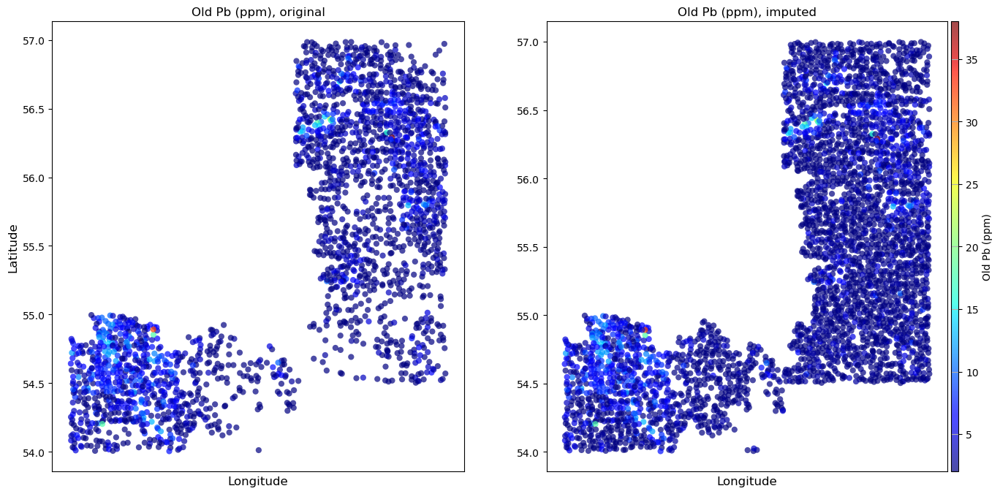

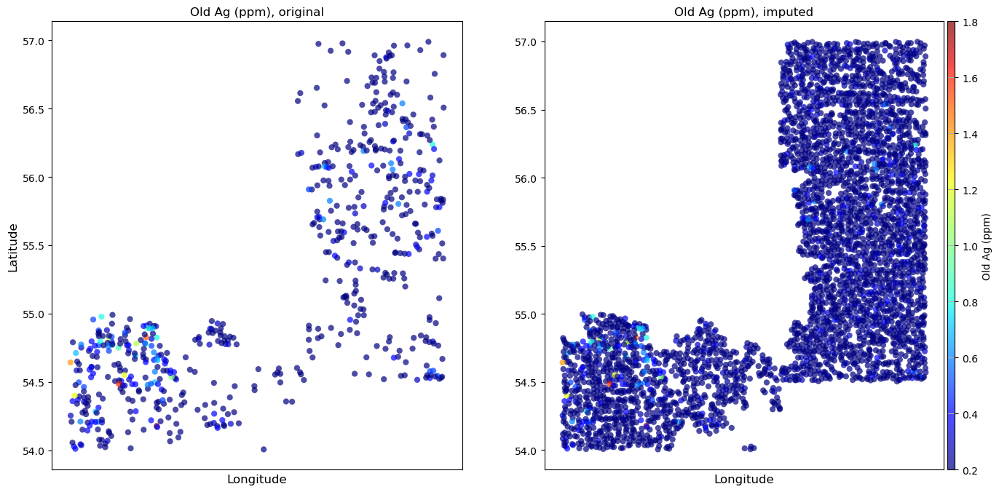

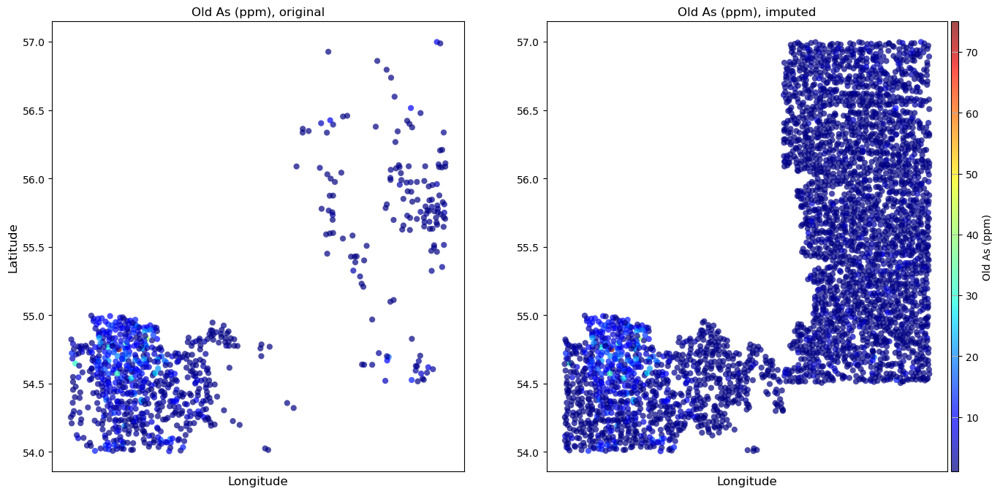

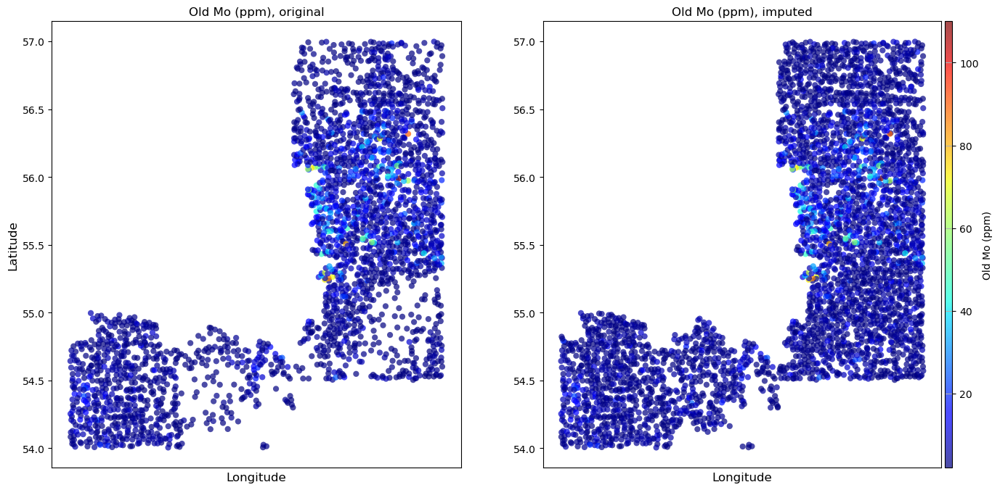

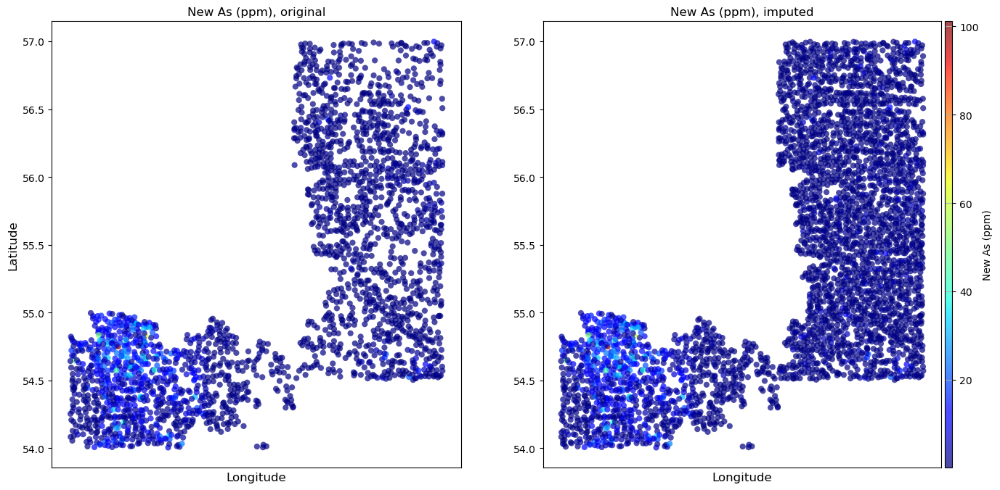

...

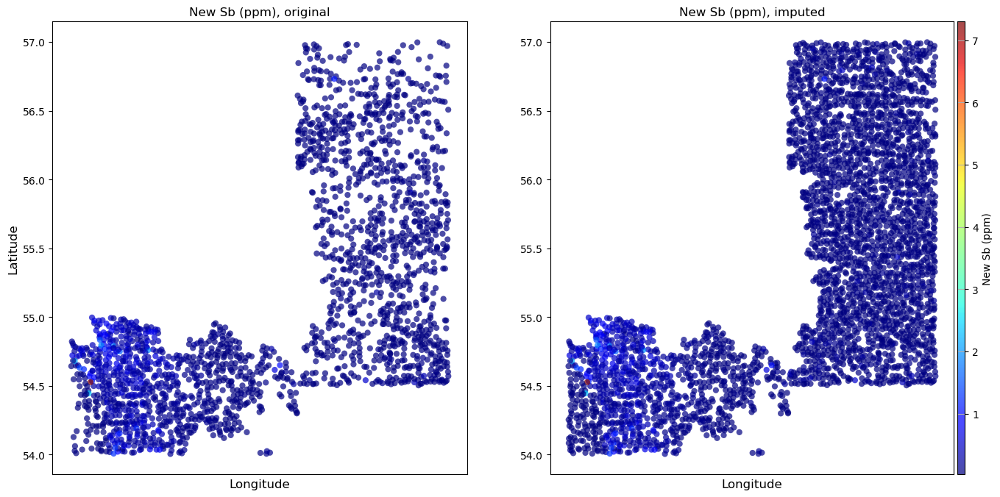

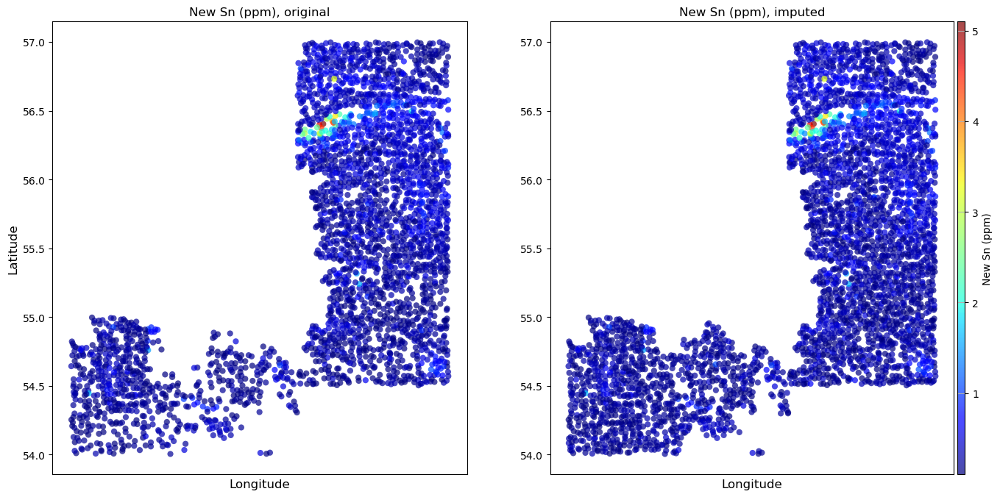

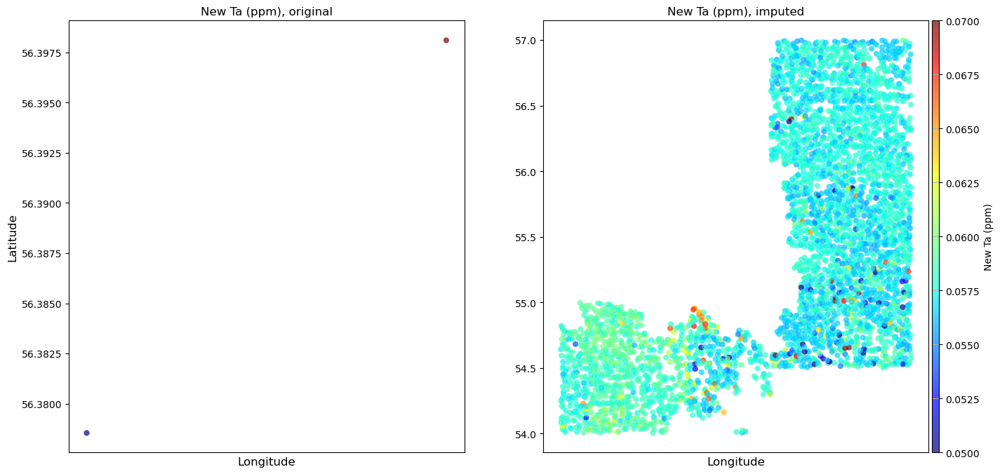

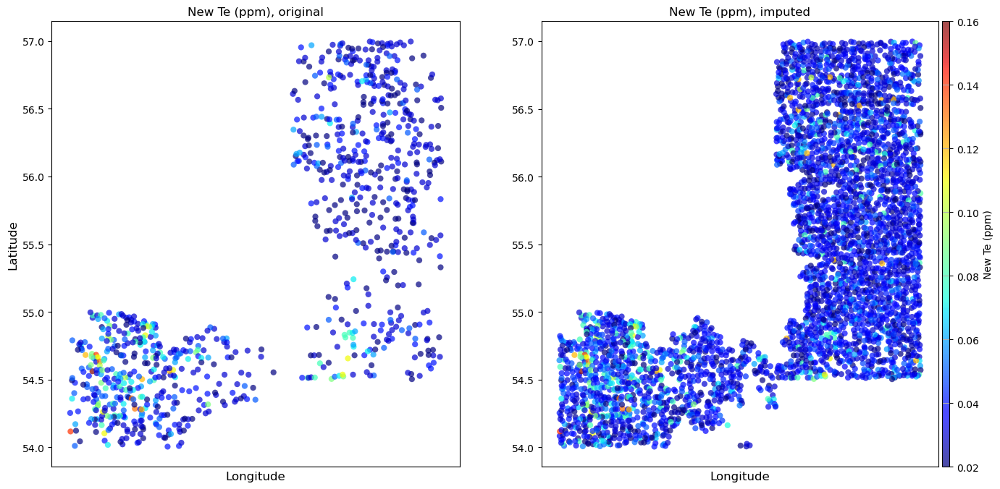

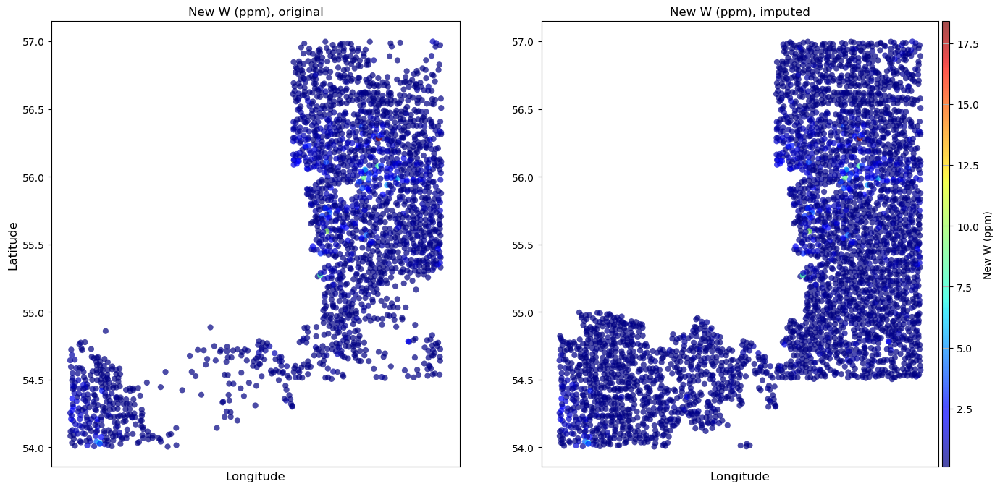

In [27]:
colormap=plt.cm.get_cmap('jet')

for element in demo_elements:
    try:
        fig, [ax1, ax2] = plt.subplots(1, 2, figsize = (16, 8))

        ax1.set_xlabel('Longitude', fontsize = 12)
        ax1.set_ylabel('Latitude', fontsize = 12)
        ax1.set_title(element+' (ppm), original', fontsize = 12)
        ax2.set_xlabel('Longitude', fontsize = 12)
        ax2.set_ylabel('', fontsize = 12)
        ax2.set_title(element+' (ppm), imputed', fontsize = 12)

        scatter1 = ax1.scatter(df['Longitude_NAD83'], df['Latitude_NAD83'], c = df[element], 
                           cmap = colormap, s = 35, alpha=0.7, label='', edgecolor = 'none')
        
        scatter2 = ax2.scatter(df['Longitude_NAD83'], df['Latitude_NAD83'], c = df[imputed_demo_elements[demo_elements.index(element)]], 
                           cmap = colormap, s = 35, alpha=0.7, label='', edgecolor = 'none')

        divider = make_axes_locatable(ax2)
        cax = divider.append_axes( 'right', size=0.1, pad= 0.05)

        cbar2 = fig.colorbar(scatter1, pad=0.01, cax = cax)
        cbar2.set_label(element+' (ppm)')

        max_x = np.ceil(max(df['Longitude_NAD83']))
        min_x = np.floor(min(df['Latitude_NAD83']))
 
        ax1.set_xticks(np.arange(min_x, max_x, 1))
        ax2.set_xticks(np.arange(min_x, max_x, 1))
        
        plt.grid()

        plt.show()       
        
        
    except:
        print("Element - "+element+" could not be plotted.")

There is no noticeable difference between the two spatial plots or map between the original and imputed New Sn.

C:\Users\mademow\AppData\Local\Temp\ipykernel_19560\3535522301.py:1: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colormap=plt.cm.get_cmap('Blues_r')


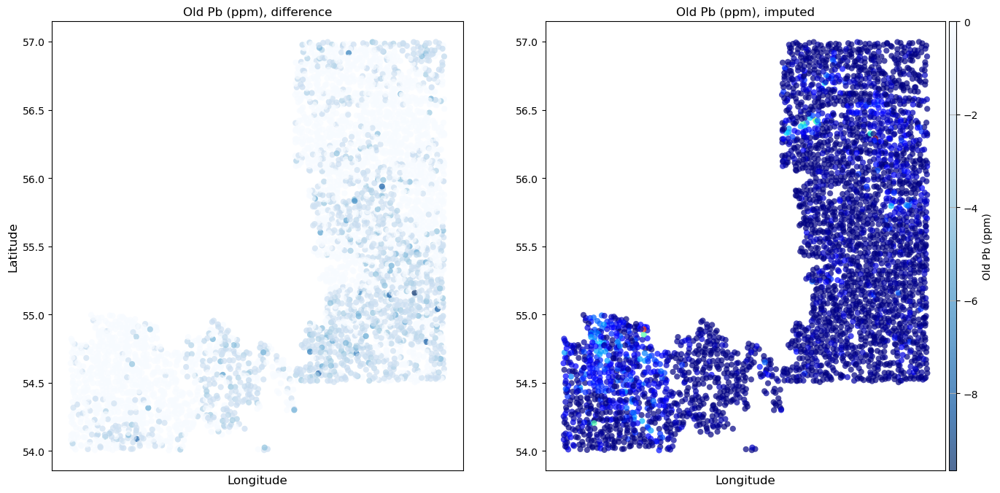

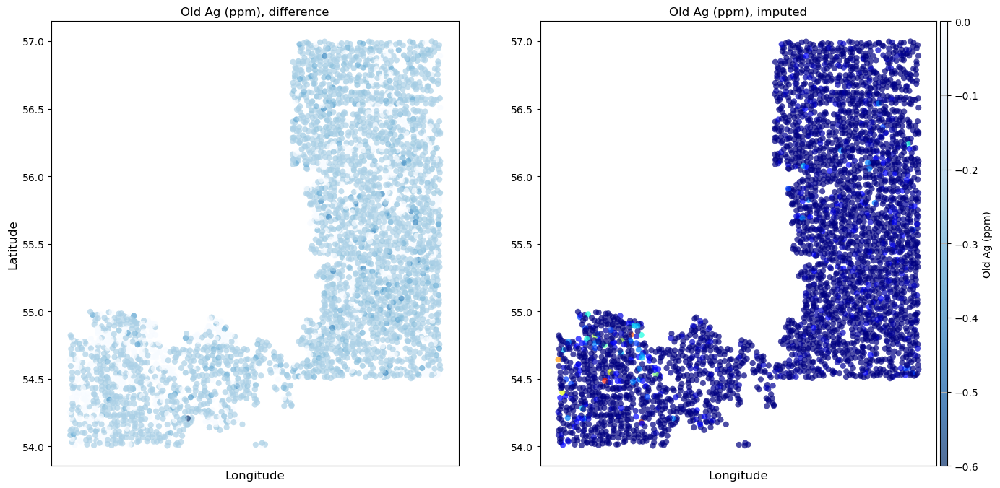

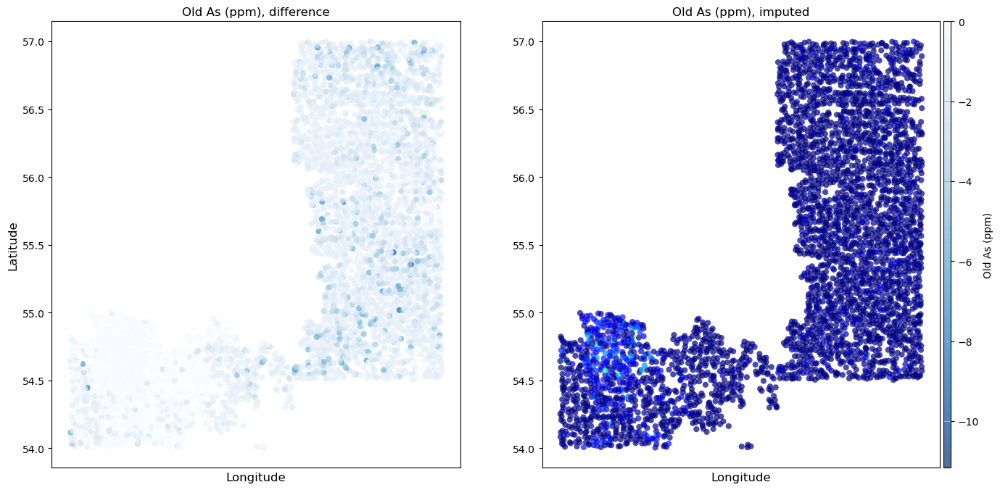

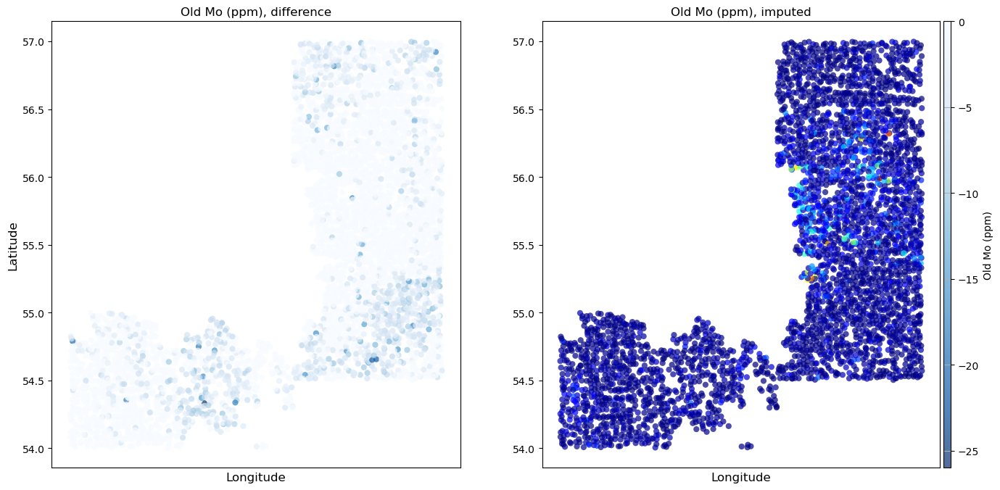

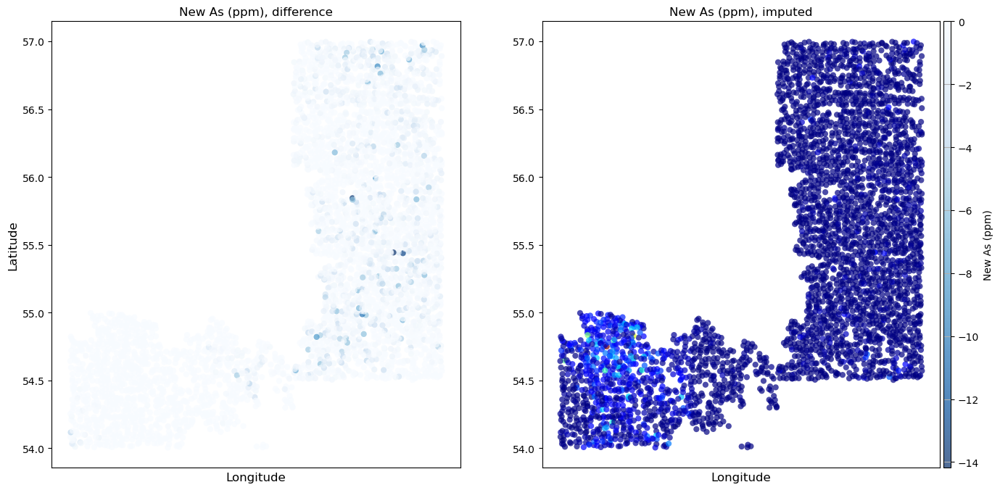

...

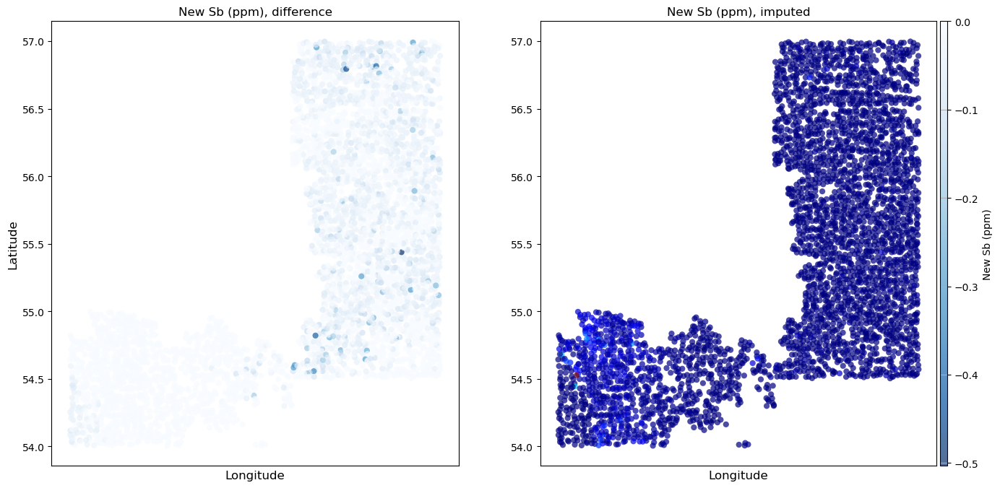

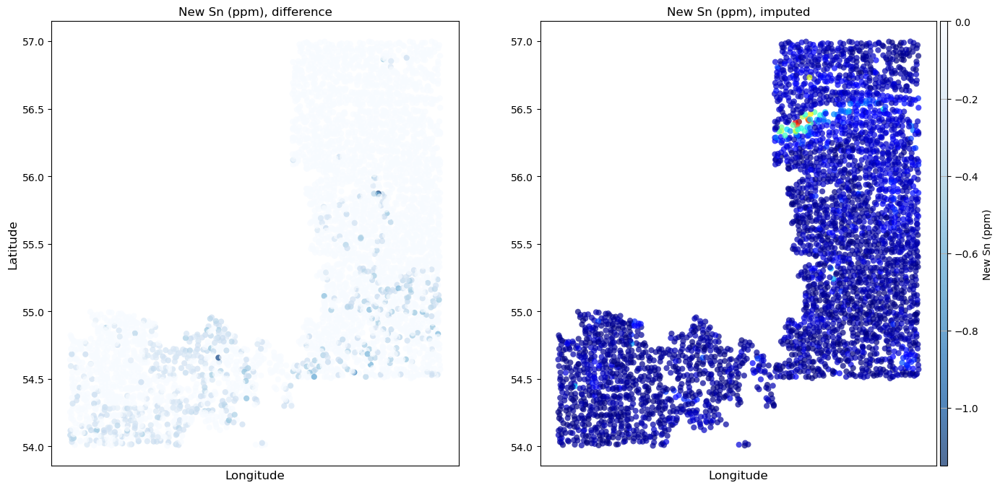

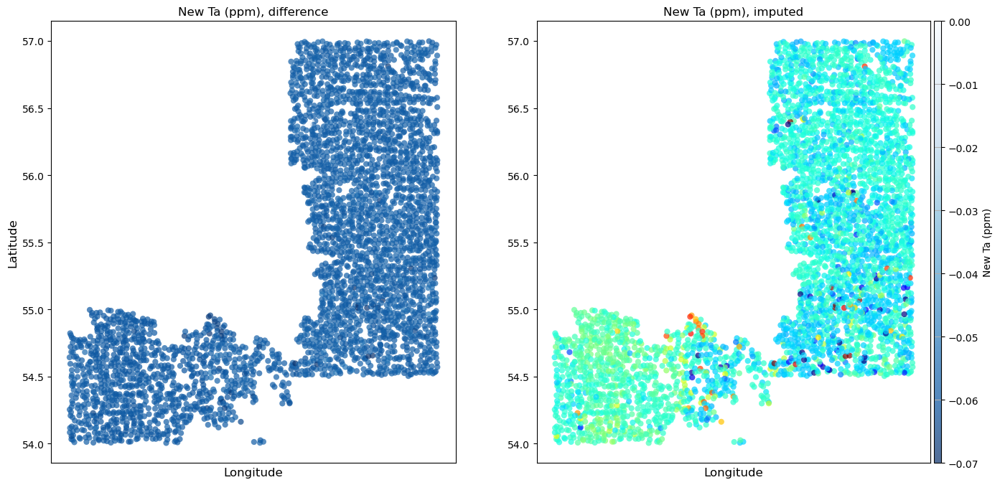

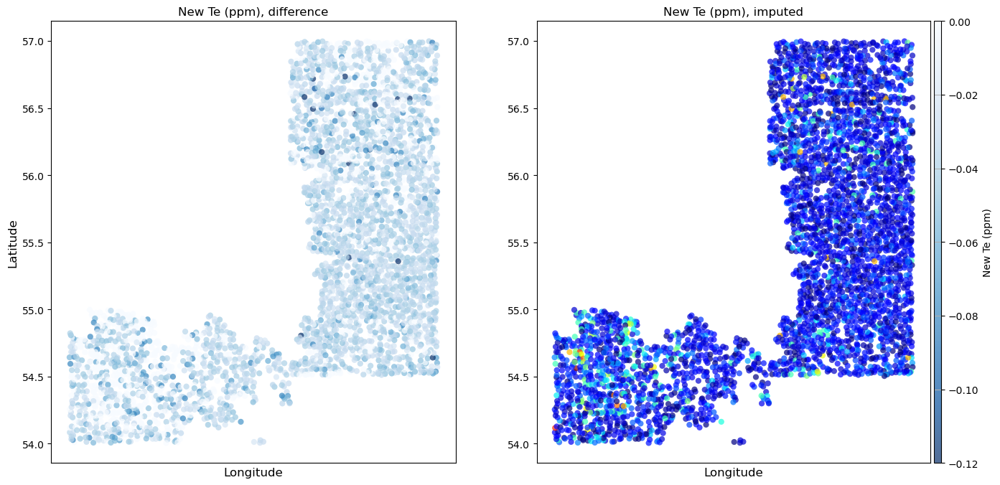

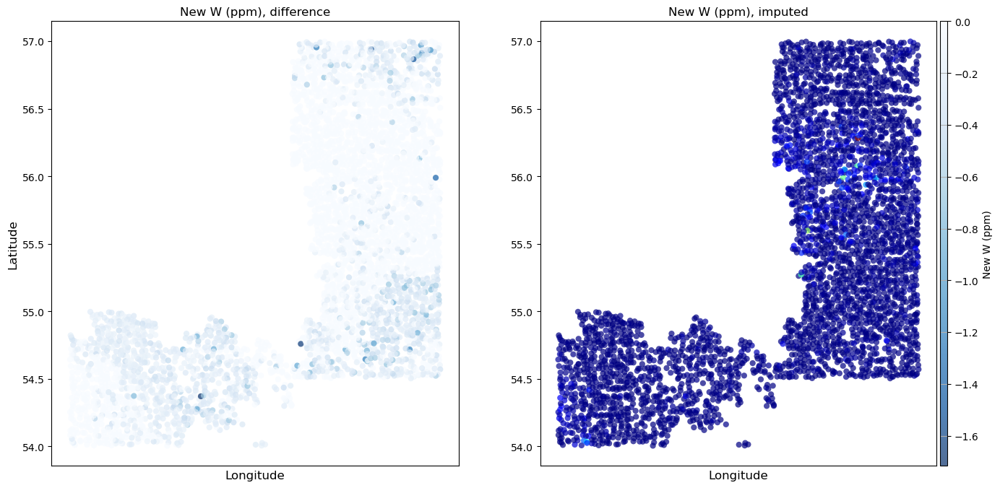

In [28]:
colormap=plt.cm.get_cmap('Blues_r')

for element in demo_elements:
    try:
        fig, [ax1, ax2] = plt.subplots(1, 2, figsize = (16, 8))

        ax1.set_xlabel('Longitude', fontsize = 12)
        ax1.set_ylabel('Latitude', fontsize = 12)
        ax1.set_title(element+' (ppm), difference', fontsize = 12)
        ax2.set_xlabel('Longitude', fontsize = 12)
        ax2.set_ylabel('', fontsize = 12)
        ax2.set_title(element+' (ppm), imputed', fontsize = 12)
        
        temp_df = df[element].copy()
        temp_df[temp_df.isna()] = 0


        scatter1 = ax1.scatter(df['Longitude_NAD83'], df['Latitude_NAD83'], c = temp_df-df[imputed_demo_elements[demo_elements.index(element)]], 
                           cmap = colormap, s = 35, alpha=0.7, label='', edgecolor = 'none')
        
        scatter2 = ax2.scatter(df['Longitude_NAD83'], df['Latitude_NAD83'], c = df[imputed_demo_elements[demo_elements.index(element)]], 
                           cmap = 'jet', s = 35, alpha=0.7, label='', edgecolor = 'none')


        divider = make_axes_locatable(ax2)
        cax = divider.append_axes( 'right', size=0.1, pad= 0.05)

        cbar2 = fig.colorbar(scatter1, pad=0.01, cax = cax)
        cbar2.set_label(element+' (ppm)')

        max_x = np.ceil(max(df['Longitude_NAD83']))
        min_x = np.floor(min(df['Latitude_NAD83']))
 
        ax1.set_xticks(np.arange(min_x, max_x, 1))
        ax2.set_xticks(np.arange(min_x, max_x, 1))
        plt.grid()

        plt.show()       
        
        
    except:
        print("Element - "+element+" could not be plotted.")

There is a noticeable difference between the two spatial plots or map.The first map shows the original data, with the missing values represented as white areas and the difference is bigger were colour gets darker. The second map shows the imputed data, with the missing values filled in using the KNN imputationThe first map shows that the missing values are not evenly distributed throughout. There are areas with a higher concentration of missing values, such as the southern and western part. 
The second map shows that the imputed values in the areas with a higher concentration of missing values are generally lower than the imputed values in the areas with a lower concentration of missing values and this may suggests that the KNN imputation algorithm may be underestimating the New Sn concentrations in the areas with a higher concentration of missing values.


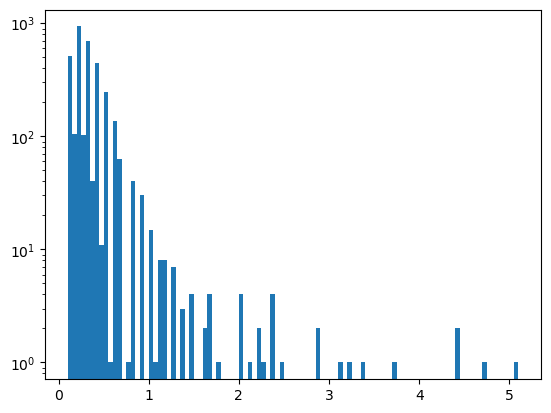

In [29]:
plt.hist(df['Imputed New Sn'], bins = 100, log = True) 
plt.show()

The histogram shows that the distribution of the imputed New Sn values is positively skewed. There are more data points with lower New Sn values than data points with higher New Sn values. There are also a few outliers, which are data points with very high or low New Sn values.

In [30]:
df[df[element].isna()]

,Unnamed: 0,Unique ID,NTS Sheet,Latitude_NAD83,Longitude_NAD83,Old Zn,Old Cu,Old Pb,Old Ni,Old Co,...,Imputed New Hf,Imputed New In,Imputed New Pd,Imputed New Pt,Imputed New Re,Imputed New Sb,Imputed New Sn,Imputed New Ta,Imputed New Te,Imputed New W
0,1,013L781002,013L,54.989093,-62.019071,40.0,38.0,NaN,43.0,10.0,...,0.03,0.027881,14.567065,2.833333,3.333333,0.038333,0.100,0.056711,0.040000,0.133333
1,2,013L781003,013L,54.975382,-62.030577,40.0,44.0,NaN,35.0,8.0,...,0.03,0.029586,12.984276,2.666668,2.500000,0.020000,0.100,0.056648,0.040000,0.300000
2,3,013L781004,013L,54.976331,-62.044913,46.0,30.0,NaN,34.0,8.0,...,0.03,0.028495,14.212741,2.000000,3.333333,0.040000,0.100,0.056648,0.042500,0.166667
3,4,013L781005,013L,54.973541,-62.054790,50.0,26.0,NaN,22.0,6.0,...,0.02,0.021350,14.253394,2.000000,3.000000,0.033333,0.100,0.056651,0.033333,0.140000
4,5,013L781007,013L,54.936983,-62.026399,42.0,20.0,NaN,22.0,9.0,...,0.02,0.025000,14.126136,2.833333,3.500000,0.056667,0.200,0.056624,0.033333,0.200000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3436,3437,023J783278,023J,54.483518,-66.172597,192.0,68.0,8.0,58.0,24.0,...,0.15,0.040000,12.707137,2.000000,8.000000,0.360000,0.300,0.059132,0.070000,0.100001
3437,3438,023J783279,023J,54.482485,-66.128816,132.0,32.0,3.0,28.0,6.0,...,0.14,0.029558,12.784183,3.000000,5.000000,0.250000,0.200,0.058241,0.040000,0.200000
3438,3439,023J783282,023J,54.483288,-66.094340,138.0,34.0,6.0,36.0,13.0,...,0.22,0.026180,14.584069,4.000000,2.000000,0.350000,0.300,0.058001,0.031427,0.166667
3439,3440,023J783283,023J,54.471281,-66.048911,168.0,46.0,6.0,25.0,7.0,...,0.07,0.029951,12.860652,3.045660,3.000000,0.270000,0.100,0.058941,0.020000,0.141903


(array([2.567e+03, 2.830e+02, 2.900e+01, 1.100e+01, 9.000e+00, 2.000e+00,
        3.000e+00, 1.000e+00, 2.000e+00, 2.000e+00]),
 array([0.1, 0.6, 1.1, 1.6, 2.1, 2.6, 3.1, 3.6, 4.1, 4.6, 5.1]),
 [<matplotlib.patches.Polygon at 0x1d76cc7fdd0>])

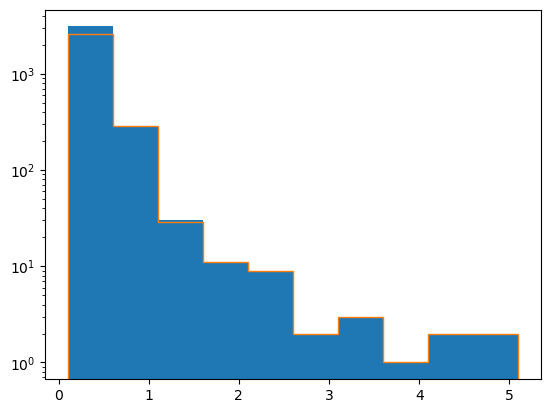

In [31]:
plt.hist(df['Imputed New Sn'], log = True)
plt.hist(df['New Sn'], histtype = 'step', log = True)

The plot shows histograms for the 'Imputed New Sn' and 'New Sn' columns  to better visualize the data distribution. The 'Imputed New Sn' histogram is shown as bars, while the 'New Sn' histogram is shown as step-like lines.The plots overlap closely and imputation added extra data points between 0 and 1.5 ppm.

In [32]:
for element in demo_elements:
    print(element, imputed_demo_elements[demo_elements.index(element)])
    temp_df1 = df[df[element].isna()][imputed_demo_elements[demo_elements.index(element)]]
    print(temp_df1.mean())

Old Pb Imputed Old Pb
2.488569794240671
Old Ag Imputed Old Ag
0.21212858648294297
Old As Imputed Old As
1.5487962336326293
Old Mo Imputed Old Mo
4.828765971328431
New As Imputed New As
1.0560058220703885
New Au Imputed New Au
0.8759610007429748
New B Imputed New B
23.411419349091666
New Bi Imputed New Bi
0.04203980457294629
New Ge Imputed New Ge
0.1362760970806455
New Hf Imputed New Hf
0.036179317621435995
New In Imputed New In
0.026513517722194433
New Pd Imputed New Pd
14.543999778537595
New Pt Imputed New Pt
2.815378802300666
New Re Imputed New Re
2.5693243649899955
New Sb Imputed New Sb
0.05070356913258485
New Sn Imputed New Sn
0.2641868998204318
New Ta Imputed New Ta
0.05770344564291336
New Te Imputed New Te
0.03812247293062072
New W Imputed New W
0.24575705475415913


The number 0.2642 represents the mean imputed value for "New Sn.

In [33]:
#Find the row with the maximum R2 score
best_r2_row = r2_df[r2_df.R2 == r2_df.R2.max()]

#Extract the "n_neighbors" and R2 score values
best_n_neighbors = best_r2_row['N'].values[0]
best_r2_score = best_r2_row['R2'].values[0]

print("n_neighbors | R2 Score")
print("-" * 24)
for index, row in r2_df.iterrows():
    n_neighbors = row['N']
    r2_score = row['R2']
    print(f"{n_neighbors:11} | {r2_score:.6f}")

print("\nThe best n_neighbors value for imputation is", best_n_neighbors, "with an R2 score of", best_r2_score)


n_neighbors | R2 Score
------------------------
        1.0 | 0.930807
        2.0 | 0.957242
        3.0 | 0.951290
        4.0 | 0.965354
        5.0 | 0.964097
        6.0 | 0.965887
        7.0 | 0.964693
        8.0 | 0.962703
        9.0 | 0.961948
       10.0 | 0.961770
       11.0 | 0.961689
       12.0 | 0.961364
       13.0 | 0.961858
       14.0 | 0.962041
       15.0 | 0.961833
       16.0 | 0.962143
       17.0 | 0.961986
       18.0 | 0.961362
       19.0 | 0.961434
       20.0 | 0.961291
       21.0 | 0.961052
       22.0 | 0.961439
       23.0 | 0.960606
       24.0 | 0.960854
       25.0 | 0.960571
       26.0 | 0.961034
       27.0 | 0.960577
       28.0 | 0.960619
       29.0 | 0.960676
       30.0 | 0.960353
       31.0 | 0.960642
       32.0 | 0.960654
       33.0 | 0.960327
       34.0 | 0.960404
       35.0 | 0.960251
       36.0 | 0.960519
       37.0 | 0.960889
       38.0 | 0.960585
       39.0 | 0.960357
       40.0 | 0.960325
       41.0 | 0.960502
       42

The table shows the R2 score for different values of the n_neighbors parameter of the KNNImputer. The R2 score is a measure of how well the imputed values match the original values. The results show that the R2 score increases with the number of neighbors, up to a point. It varies from about 0.930807 with just one neighbor to roughly 0.965887 with six neighbors. However, after n_neighbors = 6, the R2 score starts to decrease slightly as more neighbors are considered for imputation. This suggests that an intermediate value of n_neighbors, around 6, provides the best imputation performance. 